<a href="https://colab.research.google.com/github/sid2305/Book-Recommender-System/blob/main/Recommendation_using_CF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! pip install -q kaggle
from google.colab import files

In [2]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"sid2305","key":"0ea1d90ed2f51ff02eebc63f052d46bc"}'}

In [3]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d zygmunt/goodbooks-10k

 78% 9.00M/11.6M [00:00<00:00, 41.1MB/s]
100% 11.6M/11.6M [00:00<00:00, 38.6MB/s]


In [4]:
import zipfile
with zipfile.ZipFile('goodbooks-10k.zip', 'r') as zip_ref:
    zip_ref.extractall('goodbooks')

In [5]:
from __future__ import print_function

import numpy as np
import pandas as pd
import collections
from mpl_toolkits.mplot3d import Axes3D
from IPython import display
from matplotlib import pyplot as plt
import sklearn
import sklearn.manifold
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
tf.logging.set_verbosity(tf.logging.ERROR)

# Add some convenience functions to Pandas DataFrame.
pd.options.display.max_rows = 10
pd.options.display.float_format = '{:.3f}'.format
def mask(df, key, function):
  """Returns a filtered dataframe, by applying function to key"""
  return df[function(df[key])]

def flatten_cols(df):
  df.columns = [' '.join(col).strip() for col in df.columns.values]
  return df

pd.DataFrame.mask = mask
pd.DataFrame.flatten_cols = flatten_cols

Instructions for updating:
non-resource variables are not supported in the long term


In [6]:
# Install Altair and activate its colab renderer.
print("Installing Altair...")
!pip install git+git://github.com/altair-viz/altair.git
import altair as alt
alt.data_transformers.enable('default', max_rows=None)
alt.renderers.enable('colab')
print("Done installing Altair")

Installing Altair...
  Cloning git://github.com/altair-viz/altair.git to /tmp/pip-req-build-n_g9nc24
  Running command git clone -q git://github.com/altair-viz/altair.git /tmp/pip-req-build-n_g9nc24
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for altair: filename=altair-4.2.0.dev0-cp36-none-any.whl size=730019 sha256=0f6f0b24ee0bfc4fa7cdae1226facdfc213b60e6ede268cf118f7e7b81eef84e
  Stored in directory: /tmp/pip-ephem-wheel-cache-uulupo79/wheels/01/fd/91/025b6149b3949af76e93b3b3ceca5bf12cbdebc98fa46f9ec6
Successfully built altair
  Found existing installation: altair 4.1.0
    Uninstalling altair-4.1.0:
      Successfully uninstalled altair-4.1.0
Done installing Altair


In [7]:
# Install spreadsheets and import authentication module.
USER_RATINGS = False
!pip install --upgrade -q gspread
from google.colab import auth
import gspread
from oauth2client.client import GoogleCredentials

In [8]:
from urllib.request import urlretrieve
import zipfile

# urlretrieve("http://files.grouplens.org/datasets/movielens/ml-100k.zip", "movielens.zip")
zip_ref = zipfile.ZipFile('goodbooks-10k.zip', "r")
zip_ref.extractall()
print("Done. Dataset Loaded")
# print(zip_ref.read('ml-100k/u.info'))

Done. Dataset Loaded


In [9]:
books = pd.read_csv('books.csv')
books

,id,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url
0,1,2767052,2767052,2792775,272,439023483,9780439023480.000,Suzanne Collins,2008.000,The Hunger Games,"The Hunger Games (The Hunger Games, #1)",eng,4.340,4780653,4942365,155254,66715,127936,560092,1481305,2706317,https://images.gr-assets.com/books/1447303603m...,https://images.gr-assets.com/books/1447303603s...
1,2,3,3,4640799,491,439554934,9780439554930.000,"J.K. Rowling, Mary GrandPré",1997.000,Harry Potter and the Philosopher's Stone,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.440,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...
2,3,41865,41865,3212258,226,316015849,9780316015840.000,Stephenie Meyer,2005.000,Twilight,"Twilight (Twilight, #1)",en-US,3.570,3866839,3916824,95009,456191,436802,793319,875073,1355439,https://images.gr-assets.com/books/1361039443m...,https://images.gr-assets.com/books/1361039443s...
3,4,2657,2657,3275794,487,61120081,9780061120080.000,Harper Lee,1960.000,To Kill a Mockingbird,To Kill a Mockingbird,eng,4.250,3198671,3340896,72586,60427,117415,446835,1001952,1714267,https://images.gr-assets.com/books/1361975680m...,https://images.gr-assets.com/books/1361975680s...
4,5,4671,4671,245494,1356,743273567,9780743273560.000,F. Scott Fitzgerald,1925.000,The Great Gatsby,The Great Gatsby,eng,3.890,2683664,2773745,51992,86236,197621,606158,936012,947718,https://images.gr-assets.com/books/1490528560m...,https://images.gr-assets.com/books/1490528560s...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,7130616,7130616,7392860,19,441019455,9780441019460.000,Ilona Andrews,2010.000,Bayou Moon,"Bayou Moon (The Edge, #2)",eng,4.090,17204,18856,1180,105,575,3538,7860,6778,https://images.gr-assets.com/books/1307445460m...,https://images.gr-assets.com/books/1307445460s...
9996,9997,208324,208324,1084709,19,067973371X,9780679733710.000,Robert A. Caro,1990.000,Means of Ascent,"Means of Ascent (The Years of Lyndon Johnson, #2)",eng,4.250,12582,12952,395,303,551,1737,3389,6972,https://s.gr-assets.com/assets/nophoto/book/11...,https://s.gr-assets.com/assets/nophoto/book/50...
9997,9998,77431,77431,2393986,60,039330762X,9780393307630.000,Patrick O'Brian,1977.000,The Mauritius Command,The Mauritius Command,eng,4.350,9421,10733,374,11,111,1191,4240,5180,https://images.gr-assets.com/books/1455373531m...,https://images.gr-assets.com/books/1455373531s...
9998,9999,8565083,8565083,13433613,7,61711527,9780061711530.000,Peggy Orenstein,2011.000,Cinderella Ate My Daughter: Dispatches from th...,Cinderella Ate My Daughter: Dispatches from th...,eng,3.650,11279,11994,1988,275,1002,3765,4577,2375,https://images.gr-assets.com/books/1279214118m...,https://images.gr-assets.com/books/1279214118s...


In [10]:
user_ratings = pd.read_csv('ratings.csv')
user_ratings

,book_id,user_id,rating
0,1,314,5
1,1,439,3
2,1,588,5
3,1,1169,4
4,1,1185,4
...,...,...,...
981751,10000,48386,5
981752,10000,49007,4
981753,10000,49383,5
981754,10000,50124,5


In [11]:
tags =  pd.read_csv('tags.csv')
tags

,tag_id,tag_name
0,0,-
1,1,--1-
2,2,--10-
3,3,--12-
4,4,--122-
...,...,...
34247,34247,Ｃhildrens
34248,34248,Ｆａｖｏｒｉｔｅｓ
34249,34249,Ｍａｎｇａ
34250,34250,ＳＥＲＩＥＳ


In [12]:
book_tags = pd.read_csv('book_tags.csv')
book_tags

,goodreads_book_id,tag_id,count
0,1,30574,167697
1,1,11305,37174
2,1,11557,34173
3,1,8717,12986
4,1,33114,12716
...,...,...,...
999907,33288638,21303,7
999908,33288638,17271,7
999909,33288638,1126,7
999910,33288638,11478,7


In [13]:
book_tags = book_tags.merge(tags[['tag_id','tag_name']], how='left', on= ['tag_id'])
book_tags

,goodreads_book_id,tag_id,count,tag_name
0,1,30574,167697,to-read
1,1,11305,37174,fantasy
2,1,11557,34173,favorites
3,1,8717,12986,currently-reading
4,1,33114,12716,young-adult
...,...,...,...,...
999907,33288638,21303,7,neighbors
999908,33288638,17271,7,kindleunlimited
999909,33288638,1126,7,5-star-reads
999910,33288638,11478,7,fave-author


In [14]:
genre_cols = ["book_id","genre_unknown","fantasy","young-adult","adventure","fiction","sci-fi-fantasy","children","paranormal","mystery","romance"]
genre = pd.DataFrame(columns = genre_cols)
genre['book_id'] = books["book_id"]
genre.fillna(0, inplace = True)
genre = genre.sort_values('book_id')
genre

,book_id,genre_unknown,fantasy,young-adult,adventure,fiction,sci-fi-fantasy,children,paranormal,mystery,romance
26,1,0,0,0,0,0,0,0,0,0,0
20,2,0,0,0,0,0,0,0,0,0,0
1,3,0,0,0,0,0,0,0,0,0,0
17,5,0,0,0,0,0,0,0,0,0,0
23,6,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
7522,31538647,0,0,0,0,0,0,0,0,0,0
4593,31845516,0,0,0,0,0,0,0,0,0,0
9568,32075671,0,0,0,0,0,0,0,0,0,0
9579,32848471,0,0,0,0,0,0,0,0,0,0


In [15]:
temp_dict = dict()
for index_label, row_series in genre.iterrows():
  temp = book_tags.loc[book_tags['goodreads_book_id']==genre.at[index_label,'book_id']]
  # print(temp)
  count = 5
  for y in temp['tag_name']:
    if count>0:
      if y in genre_cols:
        genre.at[index_label,y] = 1
        count = count-1
    else:
        break

In [16]:
# Compute the number of movies to which a genre is assigned.
genre_occurences = genre.sum().to_dict()
genre_occurences

{'adventure': 3074,
 'book_id': 52646965132,
 'children': 1166,
 'fantasy': 4211,
 'fiction': 9049,
 'genre_unknown': 0,
 'mystery': 3082,
 'paranormal': 1543,
 'romance': 3935,
 'sci-fi-fantasy': 1574,
 'young-adult': 3441}

In [17]:
books = books.merge(genre[genre_cols], how='left', on= ['book_id'])
books

,id,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url,genre_unknown,fantasy,young-adult,adventure,fiction,sci-fi-fantasy,children,paranormal,mystery,romance
0,1,2767052,2767052,2792775,272,439023483,9780439023480.000,Suzanne Collins,2008.000,The Hunger Games,"The Hunger Games (The Hunger Games, #1)",eng,4.340,4780653,4942365,155254,66715,127936,560092,1481305,2706317,https://images.gr-assets.com/books/1447303603m...,https://images.gr-assets.com/books/1447303603s...,0,1,1,1,1,0,0,0,0,1
1,2,3,3,4640799,491,439554934,9780439554930.000,"J.K. Rowling, Mary GrandPré",1997.000,Harry Potter and the Philosopher's Stone,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.440,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...,0,1,1,1,1,0,1,0,0,0
2,3,41865,41865,3212258,226,316015849,9780316015840.000,Stephenie Meyer,2005.000,Twilight,"Twilight (Twilight, #1)",en-US,3.570,3866839,3916824,95009,456191,436802,793319,875073,1355439,https://images.gr-assets.com/books/1361039443m...,https://images.gr-assets.com/books/1361039443s...,0,1,1,0,1,1,0,1,0,0
3,4,2657,2657,3275794,487,61120081,9780061120080.000,Harper Lee,1960.000,To Kill a Mockingbird,To Kill a Mockingbird,eng,4.250,3198671,3340896,72586,60427,117415,446835,1001952,1714267,https://images.gr-assets.com/books/1361975680m...,https://images.gr-assets.com/books/1361975680s...,0,0,1,0,1,0,0,0,1,0
4,5,4671,4671,245494,1356,743273567,9780743273560.000,F. Scott Fitzgerald,1925.000,The Great Gatsby,The Great Gatsby,eng,3.890,2683664,2773745,51992,86236,197621,606158,936012,947718,https://images.gr-assets.com/books/1490528560m...,https://images.gr-assets.com/books/1490528560s...,0,0,1,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,7130616,7130616,7392860,19,441019455,9780441019460.000,Ilona Andrews,2010.000,Bayou Moon,"Bayou Moon (The Edge, #2)",eng,4.090,17204,18856,1180,105,575,3538,7860,6778,https://images.gr-assets.com/books/1307445460m...,https://images.gr-assets.com/books/1307445460s...,0,1,0,0,1,1,0,1,0,1
9996,9997,208324,208324,1084709,19,067973371X,9780679733710.000,Robert A. Caro,1990.000,Means of Ascent,"Means of Ascent (The Years of Lyndon Johnson, #2)",eng,4.250,12582,12952,395,303,551,1737,3389,6972,https://s.gr-assets.com/assets/nophoto/book/11...,https://s.gr-assets.com/assets/nophoto/book/50...,0,0,0,0,0,0,0,0,0,0
9997,9998,77431,77431,2393986,60,039330762X,9780393307630.000,Patrick O'Brian,1977.000,The Mauritius Command,The Mauritius Command,eng,4.350,9421,10733,374,11,111,1191,4240,5180,https://images.gr-assets.com/books/1455373531m...,https://images.gr-assets.com/books/1455373531s...,0,0,0,1,1,0,0,0,0,0
9998,9999,8565083,8565083,13433613,7,61711527,9780061711530.000,Peggy Orenstein,2011.000,Cinderella Ate My Daughter: Dispatches from th...,Cinderella Ate My Daughter: Dispatches from th...,eng,3.650,11279,11994,1988,275,1002,3765,4577,2375,https://images.gr-assets.com/books/1279214118m...,https://images.gr-assets.com/books/1279214118s...,0,0,0,0,0,0,1,0,0,0


In [18]:
genre_temp_cols = ["genre_unknown","fantasy","young-adult","adventure","fiction","sci-fi-fantasy","children","paranormal","mystery","romance"]
# Since some movies can belong to more than one genre, we create different
# 'genre' columns as follows:
# - all_genres: all the active genres of the movie.
# - genre: randomly sampled from the active genres.
def mark_genres(books, genres):
  def get_random_genre(gs):
    active = [genre1 for genre1, g in zip(genres, gs) if g==1]
    if len(active) == 0:
      return 'Other'
    return np.random.choice(active)
  def get_all_genres(gs):
    active = [genre1 for genre1, g in zip(genres, gs) if g==1]
    if len(active) == 0:
      return 'Other'
    return '-'.join(active)
  books['genre'] = [
      get_random_genre(gs) for gs in zip(*[books[genre1] for genre1 in genres])]
  books['all_genres'] = [
      get_all_genres(gs) for gs in zip(*[books[genre1] for genre1 in genres])]

mark_genres(books, genre_cols)
books

,id,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url,genre_unknown,fantasy,young-adult,adventure,fiction,sci-fi-fantasy,children,paranormal,mystery,romance,genre,all_genres
0,1,2767052,2767052,2792775,272,439023483,9780439023480.000,Suzanne Collins,2008.000,The Hunger Games,"The Hunger Games (The Hunger Games, #1)",eng,4.340,4780653,4942365,155254,66715,127936,560092,1481305,2706317,https://images.gr-assets.com/books/1447303603m...,https://images.gr-assets.com/books/1447303603s...,0,1,1,1,1,0,0,0,0,1,fantasy,fantasy-young-adult-adventure-fiction-romance
1,2,3,3,4640799,491,439554934,9780439554930.000,"J.K. Rowling, Mary GrandPré",1997.000,Harry Potter and the Philosopher's Stone,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.440,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...,0,1,1,1,1,0,1,0,0,0,young-adult,fantasy-young-adult-adventure-fiction-children
2,3,41865,41865,3212258,226,316015849,9780316015840.000,Stephenie Meyer,2005.000,Twilight,"Twilight (Twilight, #1)",en-US,3.570,3866839,3916824,95009,456191,436802,793319,875073,1355439,https://images.gr-assets.com/books/1361039443m...,https://images.gr-assets.com/books/1361039443s...,0,1,1,0,1,1,0,1,0,0,sci-fi-fantasy,fantasy-young-adult-fiction-sci-fi-fantasy-par...
3,4,2657,2657,3275794,487,61120081,9780061120080.000,Harper Lee,1960.000,To Kill a Mockingbird,To Kill a Mockingbird,eng,4.250,3198671,3340896,72586,60427,117415,446835,1001952,1714267,https://images.gr-assets.com/books/1361975680m...,https://images.gr-assets.com/books/1361975680s...,0,0,1,0,1,0,0,0,1,0,fiction,young-adult-fiction-mystery
4,5,4671,4671,245494,1356,743273567,9780743273560.000,F. Scott Fitzgerald,1925.000,The Great Gatsby,The Great Gatsby,eng,3.890,2683664,2773745,51992,86236,197621,606158,936012,947718,https://images.gr-assets.com/books/1490528560m...,https://images.gr-assets.com/books/1490528560s...,0,0,1,0,1,0,0,0,0,1,romance,young-adult-fiction-romance
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,7130616,7130616,7392860,19,441019455,9780441019460.000,Ilona Andrews,2010.000,Bayou Moon,"Bayou Moon (The Edge, #2)",eng,4.090,17204,18856,1180,105,575,3538,7860,6778,https://images.gr-assets.com/books/1307445460m...,https://images.gr-assets.com/books/1307445460s...,0,1,0,0,1,1,0,1,0,1,romance,fantasy-fiction-sci-fi-fantasy-paranormal-romance
9996,9997,208324,208324,1084709,19,067973371X,9780679733710.000,Robert A. Caro,1990.000,Means of Ascent,"Means of Ascent (The Years of Lyndon Johnson, #2)",eng,4.250,12582,12952,395,303,551,1737,3389,6972,https://s.gr-assets.com/assets/nophoto/book/11...,https://s.gr-assets.com/assets/nophoto/book/50...,0,0,0,0,0,0,0,0,0,0,Other,Other
9997,9998,77431,77431,2393986,60,039330762X,9780393307630.000,Patrick O'Brian,1977.000,The Mauritius Command,The Mauritius Command,eng,4.350,9421,10733,374,11,111,1191,4240,5180,https://images.gr-assets.com/books/1455373531m...,https://images.gr-assets.com/books/1455373531s...,0,0,0,1,1,0,0,0,0,0,adventure,adventure-fiction
9998,9999,8565083,8565083,13433613,7,61711527,9780061711530.000,Peggy Orenstein,2011.000,Cinderella Ate My Daughter: Dispatches from th...,Cinderella Ate My Daughter: Dispatches from th...,eng,3.650,11279,11994,1988,275,1002,3765,4577,2375,https://images.gr-assets.com/books/1279214118m...,https://images.gr-assets.com/books/1279214118s...,0,0,0,0,0,0,1,0,0,0,children,children


In [19]:
# Create one merged DataFrame containing all the movielens data.
books_users = user_ratings.merge(books, on='book_id')
books_users

,book_id,user_id,rating,id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url,genre_unknown,fantasy,young-adult,adventure,fiction,sci-fi-fantasy,children,paranormal,mystery,romance,genre,all_genres
0,1,314,5,27,1,41335427,275,439785960,9780439785970.000,"J.K. Rowling, Mary GrandPré",2005.000,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.540,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...,0,1,1,1,1,0,1,0,0,0,fantasy,book_id-fantasy-young-adult-adventure-fiction-...
1,1,439,3,27,1,41335427,275,439785960,9780439785970.000,"J.K. Rowling, Mary GrandPré",2005.000,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.540,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...,0,1,1,1,1,0,1,0,0,0,fantasy,book_id-fantasy-young-adult-adventure-fiction-...
2,1,588,5,27,1,41335427,275,439785960,9780439785970.000,"J.K. Rowling, Mary GrandPré",2005.000,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.540,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...,0,1,1,1,1,0,1,0,0,0,fantasy,book_id-fantasy-young-adult-adventure-fiction-...
3,1,1169,4,27,1,41335427,275,439785960,9780439785970.000,"J.K. Rowling, Mary GrandPré",2005.000,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.540,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...,0,1,1,1,1,0,1,0,0,0,fantasy,book_id-fantasy-young-adult-adventure-fiction-...
4,1,1185,4,27,1,41335427,275,439785960,9780439785970.000,"J.K. Rowling, Mary GrandPré",2005.000,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.540,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...,0,1,1,1,1,0,1,0,0,0,fantasy,book_id-fantasy-young-adult-adventure-fiction-...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79696,9998,51295,5,8114,9998,58336,90,679733787,9780679733780.000,"Kōbō Abe, E. Dale Saunders",1962.000,砂の女 [Suna no onna],The Woman in the Dunes,eng,3.910,11467,13886,1026,264,838,3046,5523,4215,https://images.gr-assets.com/books/1361254930m...,https://images.gr-assets.com/books/1361254930s...,0,1,0,0,1,0,0,0,1,0,fiction,fantasy-fiction-mystery
79697,9998,51559,5,8114,9998,58336,90,679733787,9780679733780.000,"Kōbō Abe, E. Dale Saunders",1962.000,砂の女 [Suna no onna],The Woman in the Dunes,eng,3.910,11467,13886,1026,264,838,3046,5523,4215,https://images.gr-assets.com/books/1361254930m...,https://images.gr-assets.com/books/1361254930s...,0,1,0,0,1,0,0,0,1,0,fiction,fantasy-fiction-mystery
79698,9998,52087,4,8114,9998,58336,90,679733787,9780679733780.000,"Kōbō Abe, E. Dale Saunders",1962.000,砂の女 [Suna no onna],The Woman in the Dunes,eng,3.910,11467,13886,1026,264,838,3046,5523,4215,https://images.gr-assets.com/books/1361254930m...,https://images.gr-assets.com/books/1361254930s...,0,1,0,0,1,0,0,0,1,0,fiction,fantasy-fiction-mystery
79699,9998,52330,4,8114,9998,58336,90,679733787,9780679733780.000,"Kōbō Abe, E. Dale Saunders",1962.000,砂の女 [Suna no onna],The Woman in the Dunes,eng,3.910,11467,13886,1026,264,838,3046,5523,4215,https://images.gr-assets.com/books/1361254930m...,https://imag

In [20]:
# Utility to split the data into training and test sets.
def split_dataframe(df, holdout_fraction=0.1):
  """Splits a DataFrame into training and test sets.
  Args:
    df: a dataframe.
    holdout_fraction: fraction of dataframe rows to use in the test set.
  Returns:
    train: dataframe for training
    test: dataframe for testing
  """
  test = df.sample(frac=holdout_fraction, replace=False)
  train = df[~df.index.isin(test.index)]
  return train, test

I. Exploring the Goodreads Dataset

In [21]:
# The following functions are used to generate interactive Altair charts.
# We will display histograms of the data, sliced by a given attribute.

# Create filters to be used to slice the data.
occupation_filter = alt.selection_multi(fields=["occupation"])
occupation_chart = alt.Chart().mark_bar().encode(
    x="count()",
    y=alt.Y("occupation:N"),
    color=alt.condition(
        occupation_filter,
        alt.Color("occupation:N", scale=alt.Scale(scheme='category20')),
        alt.value("lightgray")),
).properties(width=300, height=300, selection=occupation_filter)

# A function that generates a histogram of filtered data.
def filtered_hist(field, label, filter):
  """Creates a layered chart of histograms.
  The first layer (light gray) contains the histogram of the full data, and the
  second contains the histogram of the filtered data.
  Args:
    field: the field for which to generate the histogram.
    label: String label of the histogram.
    filter: an alt.Selection object to be used to filter the data.
  """
  base = alt.Chart().mark_bar().encode(
      x=alt.X(field, bin=alt.Bin(maxbins=10), title=label),
      y="count()",
  ).properties(
      width=300,
  )
  return alt.layer(
      base.transform_filter(filter),
      base.encode(color=alt.value('lightgray'), opacity=alt.value(.7)),
  ).resolve_scale(y='independent')

In [22]:
genre_filter = alt.selection_multi(fields=['genre'])
genre_chart = alt.Chart().mark_bar().encode(
    x="count()",
    y=alt.Y('genre'),
    color=alt.condition(
        genre_filter,
        alt.Color("genre:N"),
        alt.value('lightgray'))
).properties(height=300, selection=genre_filter)

In [23]:
(books[['title', 'ratings_count', 'average_rating']]
 .sort_values('ratings_count', ascending=False)
 .head(10))

,title,ratings_count,average_rating
0,"The Hunger Games (The Hunger Games, #1)",4780653,4.340
1,Harry Potter and the Sorcerer's Stone (Harry P...,4602479,4.440
2,"Twilight (Twilight, #1)",3866839,3.570
3,To Kill a Mockingbird,3198671,4.250
4,The Great Gatsby,2683664,3.890
5,The Fault in Our Stars,2346404,4.260
6,The Hobbit,2071616,4.250
7,The Catcher in the Rye,2044241,3.790
9,Pride and Prejudice,2035490,4.240
8,"Angels & Demons (Robert Langdon, #1)",2001311,3.850


In [24]:
(books[['title', 'ratings_count', 'average_rating']]
 .mask('ratings_count', lambda x: x > 20)
 .sort_values('average_rating', ascending=False)
 .head(10))

,title,ratings_count,average_rating
3627,The Complete Calvin and Hobbes,28900,4.820
3274,"Harry Potter Boxed Set, Books 1-5 (Harry Potte...",33220,4.770
861,"Words of Radiance (The Stormlight Archive, #2)",73572,4.770
8853,Mark of the Lion Trilogy,9081,4.760
7946,ESV Study Bible,8953,4.760
4482,It's a Magical World: A Calvin and Hobbes Coll...,22351,4.750
6360,There's Treasure Everywhere: A Calvin and Hobb...,16766,4.740
421,"Harry Potter Boxset (Harry Potter, #1-7)",190050,4.740
3752,"Harry Potter Collection (Harry Potter, #1-6)",24618,4.730
6919,The Indispensable Calvin and Hobbes,14597,4.730


In [25]:
# Display the number of ratings and average rating per movie.
alt.hconcat(
    filtered_hist('ratings_count', '# ratings / books', genre_filter),
    filtered_hist('average_rating', 'mean books rating', genre_filter),
    genre_chart,
    data=books)

alt.HConcatChart(...)

In [26]:
def build_rating_sparse_tensor(ratings_df):
  """
  Args:
    ratings_df: a pd.DataFrame with `user_id`, `movie_id` and `rating` columns.
  Returns:
    a tf.SparseTensor representing the ratings matrix.
  """
  indices = ratings_df[['user_id', 'book_id']].values
  values = ratings_df['rating'].values
  return tf.SparseTensor(
      indices=indices,
      values=values,
      dense_shape=[user_ratings.shape[0], books.shape[0]])

In [27]:
def sparse_mean_square_error(sparse_ratings, user_embeddings, books_embeddings):
  """
  Args:
    sparse_ratings: A SparseTensor rating matrix, of dense_shape [N, M]
    user_embeddings: A dense Tensor U of shape [N, k] where k is the embedding
      dimension, such that U_i is the embedding of user i.
    movie_embeddings: A dense Tensor V of shape [M, k] where k is the embedding
      dimension, such that V_j is the embedding of movie j.
  Returns:
    A scalar Tensor representing the MSE between the true ratings and the
      model's predictions.
  """
  predictions = tf.reduce_sum(
      tf.gather(user_embeddings, sparse_ratings.indices[:, 0]) *
      tf.gather(books_embeddings, sparse_ratings.indices[:, 1]),
      axis=1)
  loss = tf.losses.mean_squared_error(sparse_ratings.values, predictions)
  return loss

In [36]:
class CFModel(object):
  """Simple class that represents a collaborative filtering model"""
  def __init__(self, embedding_vars, loss, metrics=None):
    """Initializes a CFModel.
    Args:
      embedding_vars: A dictionary of tf.Variables.
      loss: A float Tensor. The loss to optimize.
      metrics: optional list of dictionaries of Tensors. The metrics in each
        dictionary will be plotted in a separate figure during training.
    """
    self._embedding_vars = embedding_vars
    self._loss = loss
    self._metrics = metrics
    self._embeddings = {k: None for k in embedding_vars}
    self._session = None

  @property
  def embeddings(self):
    """The embeddings dictionary."""
    return self._embeddings

  def train(self, num_iterations=100, learning_rate=1.0, plot_results=True,
            optimizer=tf.train.GradientDescentOptimizer):
    """Trains the model.
    Args:
      iterations: number of iterations to run.
      learning_rate: optimizer learning rate.
      plot_results: whether to plot the results at the end of training.
      optimizer: the optimizer to use. Default to GradientDescentOptimizer.
    Returns:
      The metrics dictionary evaluated at the last iteration.
    """
    with self._loss.graph.as_default():
      opt = optimizer(learning_rate)
      train_op = opt.minimize(self._loss)
      local_init_op = tf.group(
          tf.variables_initializer(opt.variables()),
          tf.local_variables_initializer())
      if self._session is None:
        self._session = tf.Session()
        with self._session.as_default():
          self._session.run(tf.global_variables_initializer())
          self._session.run(tf.tables_initializer())
          tf.train.start_queue_runners()
          # saver = tf.train.Saver()

    with self._session.as_default():
      local_init_op.run()
      iterations = []
      metrics = self._metrics or ({},)
      metrics_vals = [collections.defaultdict(list) for _ in self._metrics]

      # Train and append results.
      for i in range(num_iterations + 1):
        _, results = self._session.run((train_op, metrics))
        if (i % 10 == 0) or i == num_iterations:
          print("\r iteration %d: " % i + ", ".join(
                ["%s=%f" % (k, v) for r in results for k, v in r.items()]),
                end='')
          # save_path = saver.save(self._session, "/CF/model.ckpt")
          # print("Model saved in path: %s" % save_path)
          iterations.append(i)
          for metric_val, result in zip(metrics_vals, results):
            for k, v in result.items():
              metric_val[k].append(v)
 
      for k, v in self._embedding_vars.items():
        self._embeddings[k] = v.eval()

      if plot_results:
        # Plot the metrics.
        num_subplots = len(metrics)+1
        fig = plt.figure()
        fig.set_size_inches(num_subplots*10, 8)
        for i, metric_vals in enumerate(metrics_vals):
          ax = fig.add_subplot(1, num_subplots, i+1)
          for k, v in metric_vals.items():
            ax.plot(iterations, v, label=k)
          ax.set_xlim([1, num_iterations])
          ax.legend()
      return results

In [37]:
def build_model(ratings, embedding_dim=3, init_stddev=1.):
  """
  Args:
    ratings: a DataFrame of the ratings
    embedding_dim: the dimension of the embedding vectors.
    init_stddev: float, the standard deviation of the random initial embeddings.
  Returns:
    model: a CFModel.
  """
  # Split the ratings DataFrame into train and test.
  train_ratings, test_ratings = split_dataframe(ratings)
  # SparseTensor representation of the train and test datasets.
  A_train = build_rating_sparse_tensor(train_ratings)
  A_test = build_rating_sparse_tensor(test_ratings)
  # Initialize the embeddings using a normal distribution.
  U = tf.Variable(tf.random_normal(
      [A_train.dense_shape[0], embedding_dim], stddev=init_stddev))
  V = tf.Variable(tf.random_normal(
      [A_train.dense_shape[1], embedding_dim], stddev=init_stddev))
  train_loss = sparse_mean_square_error(A_train, U, V)
  test_loss = sparse_mean_square_error(A_test, U, V)
  metrics = {
      'train_error': train_loss,
      'test_error': test_loss
  }
  embeddings = {
      "user_id": U,
      "book_id": V
  }
  return CFModel(embeddings, train_loss, [metrics])

In [38]:
# Build the CF model and train it.
model = build_model(user_ratings, embedding_dim=10, init_stddev=0.5)

 iteration 5000: train_error=0.545474, test_error=1.717055

[{'test_error': 1.7170553, 'train_error': 0.5454738}]

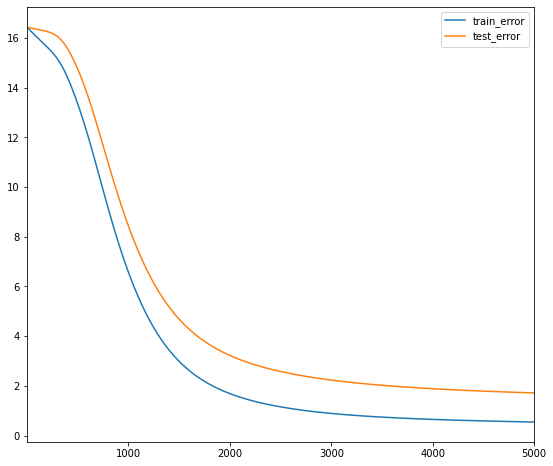

In [39]:
model.train(num_iterations=5000, learning_rate=10.)

In [40]:
DOT = 'dot'
COSINE = 'cosine'
def compute_scores(query_embedding, item_embeddings, measure=DOT):
  """Computes the scores of the candidates given a query.
  Args:
    query_embedding: a vector of shape [k], representing the query embedding.
    item_embeddings: a matrix of shape [N, k], such that row i is the embedding
      of item i.
    measure: a string specifying the similarity measure to be used. Can be
      either DOT or COSINE.
  Returns:
    scores: a vector of shape [N], such that scores[i] is the score of item i.
  """
  u = query_embedding
  V = item_embeddings
  if measure == COSINE:
    V = V / np.linalg.norm(V, axis=1, keepdims=True)
    u = u / np.linalg.norm(u)
  scores = u.dot(V.T)
  return scores

In [41]:
#User recommendations and nearest neighbors
def user_recommendations(model, measure=DOT, exclude_rated=False, k=6):
  if USER_RATINGS:
    scores = compute_scores(
        model.embeddings["user_id"][943], model.embeddings["book_id"], measure)
    score_key = measure + ' score'
    df = pd.DataFrame({
        score_key: list(scores),
        'book_id': books['book_id'],
        'titles':  books['title'],
        'genres':  books['all_genres'],
    })
    if exclude_rated:
      # remove movies that are already rated
      rated_books = ratings[ratings.user_id == "943"]["book_id"].values
      df = df[df.book_id.apply(lambda book_id: book_id not in rated_books)]
    display.display(df.sort_values([score_key], ascending=False).head(k))  

def book_neighbors(model, title_substring, measure=DOT, k=6):
  # Search for movie ids that match the given substring.
  ids =  books[books['title'].str.contains(title_substring)].index.values
  titles = books.iloc[ids]['title'].values
  if len(titles) == 0:
    raise ValueError("Found no books with title %s" % title_substring)
  print("Nearest neighbors of : %s." % titles[0])
  if len(titles) > 1:
    print("[Found more than one matching book. Other candidates: {}]".format(
        ", ".join(titles[1:])))
  book_id = ids[0]
  scores = compute_scores(
      model.embeddings["book_id"][book_id], model.embeddings["book_id"],
      measure)
  score_key = measure + ' score'
  df = pd.DataFrame({
      score_key: list(scores),
      'titles': books['title'],
      'genres': books['all_genres']
  })
  display.display(df.sort_values([score_key], ascending=False).head(k))

In [42]:
user_recommendations(model, measure=COSINE, k=5)

In [43]:
book_neighbors(model, "Harry Potter", DOT)
book_neighbors(model, "Harry Potter", COSINE)

Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: A Pop-Up Book: Based on the Film Phenomenon, Harry Potter an

,dot score,titles,genres
4410,9.688,"The Art of the Start: The Time-Tested, Battle-...",Other
8747,9.594,رأيت رام الله,fiction
7173,9.326,"Finally (Willow Falls, #2)",fantasy-young-adult-adventure-fiction-children
7677,9.171,Promises to Keep,fiction-romance
9303,9.155,Poetics,fiction
9329,9.152,"The Elves of Cintra (Genesis of Shannara, #2)",fantasy-young-adult-adventure-fiction-sci-fi-f...


Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: A Pop-Up Book: Based on the Film Phenomenon, Harry Potter an

,cosine score,titles,genres
1,1.000,Harry Potter and the Sorcerer's Stone (Harry P...,fantasy-young-adult-adventure-fiction-children
902,0.984,Anthem,fantasy-young-adult-fiction-sci-fi-fantasy-rom...
660,0.979,"Alexander and the Terrible, Horrible, No Good,...",young-adult-fiction-children
4358,0.971,"Women in Love (Brangwen Family, #2)",fiction-romance
170,0.970,Emma,fiction-romance
851,0.970,When Breath Becomes Air,fiction


In [44]:
# Embedding Visualization code (run this cell)

def book_embedding_norm(models):
  """Visualizes the norm and number of ratings of the movie embeddings.
  Args:
    model: A MFModel object.
  """
  if not isinstance(models, list):
    models = [models]
  df = pd.DataFrame({
      'title': books['title'],
      'genre': books['genre'],
      'num_ratings': books['ratings_count'],
  })
  charts = []
  brush = alt.selection_interval()
  for i, model in enumerate(models):
    norm_key = 'norm'+str(i)
    df[norm_key] = np.linalg.norm(model.embeddings["book_id"], axis=1)
    nearest = alt.selection(
        type='single', encodings=['x', 'y'], on='mouseover', nearest=True,
        empty='none')
    base = alt.Chart().mark_circle().encode(
        x='num_ratings',
        y=norm_key,
        color=alt.condition(brush, alt.value('#4c78a8'), alt.value('lightgray'))
    ).properties(
        selection=nearest).add_selection(brush)
    text = alt.Chart().mark_text(align='center', dx=5, dy=-5).encode(
        x='num_ratings', y=norm_key,
        text=alt.condition(nearest, 'title', alt.value('')))
    charts.append(alt.layer(base, text))
  return alt.hconcat(*charts, data=df)

def visualize_movie_embeddings(data, x, y):
  nearest = alt.selection(
      type='single', encodings=['x', 'y'], on='mouseover', nearest=True,
      empty='none')
  base = alt.Chart().mark_circle().encode(
      x=x,
      y=y,
      color=alt.condition(genre_filter, "genre", alt.value("whitesmoke")),
  ).properties(
      width=600,
      height=600,
      selection=nearest)
  text = alt.Chart().mark_text(align='left', dx=5, dy=-5).encode(
      x=x,
      y=y,
      text=alt.condition(nearest, 'title', alt.value('')))
  return alt.hconcat(alt.layer(base, text), genre_chart, data=data)

def tsne_movie_embeddings(model):
  """Visualizes the movie embeddings, projected using t-SNE with Cosine measure.
  Args:
    model: A MFModel object.
  """
  tsne = sklearn.manifold.TSNE(
      n_components=2, perplexity=40, metric='cosine', early_exaggeration=10.0,
      init='pca', verbose=True, n_iter=400)

  print('Running t-SNE...')
  V_proj = tsne.fit_transform(model.embeddings["book_id"])
  books.loc[:,'x'] = V_proj[:, 0]
  books.loc[:,'y'] = V_proj[:, 1]
  return visualize_movie_embeddings(books, 'x', 'y')

In [45]:
book_embedding_norm(model)

alt.HConcatChart(...)

 iteration 1000: train_error=10.283220, test_error=10.504419Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: 

,dot score,titles,genres
267,4.111,Never Let Me Go,fantasy-young-adult-fiction-sci-fi-fantasy-rom...
769,4.072,Julius Caesar,young-adult-fiction
780,4.065,"Specials (Uglies, #3)",fantasy-young-adult-adventure-fiction-romance
490,4.048,"Untamed (House of Night, #4)",fantasy-young-adult-fiction-paranormal-romance
1010,3.999,People of the Book,fiction-mystery
998,3.998,"Tales of a Fourth Grade Nothing (Fudge, #1)",young-adult-fiction-children


Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: A Pop-Up Book: Based on the Film Phenomenon, Harry Potter an

,cosine score,titles,genres
1,1.000,Harry Potter and the Sorcerer's Stone (Harry P...,fantasy-young-adult-adventure-fiction-children
829,0.981,The DUFF: Designated Ugly Fat Friend,young-adult-fiction-romance
158,0.980,The Battle of the Labyrinth (Percy Jackson and...,fantasy-young-adult-adventure-fiction-children
57,0.979,The Adventures of Huckleberry Finn,young-adult-adventure-fiction-children
106,0.979,A Walk to Remember,fiction-romance
664,0.978,"The Passage (The Passage, #1)",fantasy-fiction-sci-fi-fantasy


alt.HConcatChart(...)

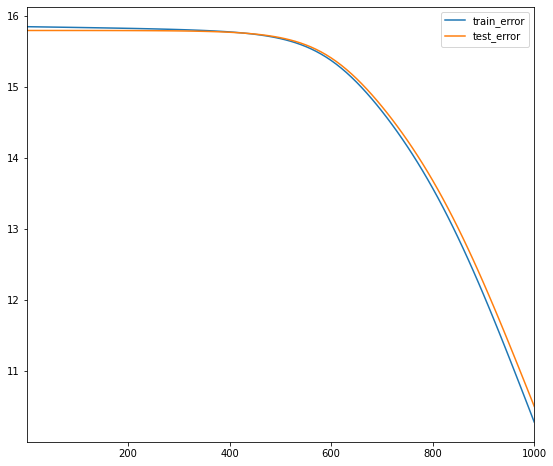

In [46]:
model_lowinit = build_model(user_ratings, embedding_dim=30, init_stddev=0.05)
model_lowinit.train(num_iterations=1000, learning_rate=10.)
book_neighbors(model_lowinit, "Harry Potter", DOT)
book_neighbors(model_lowinit, "Harry Potter", COSINE)
book_embedding_norm([model, model_lowinit])

In [47]:
tsne_movie_embeddings(model)

Running t-SNE...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.001s...
[t-SNE] Computed neighbors for 10000 samples in 1.887s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 0.110310
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.261742
[t-SNE] KL divergence after 400 iterations: 3.111086


alt.HConcatChart(...)

Build a regularized Matrix Factorization model and train it

In [48]:
def gravity(U, V):
  """Creates a gravity loss given two embedding matrices."""
  return 1. / (U.shape[0].value*V.shape[0].value) * tf.reduce_sum(
      tf.matmul(U, U, transpose_a=True) * tf.matmul(V, V, transpose_a=True))

def build_regularized_model(
    ratings, embedding_dim=3, regularization_coeff=.1, gravity_coeff=1.,
    init_stddev=0.1):
  """
  Args:
    ratings: the DataFrame of movie ratings.
    embedding_dim: The dimension of the embedding space.
    regularization_coeff: The regularization coefficient lambda.
    gravity_coeff: The gravity regularization coefficient lambda_g.
  Returns:
    A CFModel object that uses a regularized loss.
  """
  # Split the ratings DataFrame into train and test.
  train_ratings, test_ratings = split_dataframe(ratings)
  # SparseTensor representation of the train and test datasets.
  A_train = build_rating_sparse_tensor(train_ratings)
  A_test = build_rating_sparse_tensor(test_ratings)
  U = tf.Variable(tf.random_normal(
      [A_train.dense_shape[0], embedding_dim], stddev=init_stddev))
  V = tf.Variable(tf.random_normal(
      [A_train.dense_shape[1], embedding_dim], stddev=init_stddev))

  error_train = sparse_mean_square_error(A_train, U, V)
  error_test = sparse_mean_square_error(A_test, U, V)
  gravity_loss = gravity_coeff * gravity(U, V)
  regularization_loss = regularization_coeff * (
      tf.reduce_sum(U*U)/U.shape[0].value + tf.reduce_sum(V*V)/V.shape[0].value)
  total_loss = error_train + regularization_loss + gravity_loss
  losses = {
      'train_error_observed': error_train,
      'test_error_observed': error_test,
  }
  loss_components = {
      'observed_loss': error_train,
      'regularization_loss': regularization_loss,
      'gravity_loss': gravity_loss,
  }
  embeddings = {"user_id": U, "book_id": V}

  return CFModel(embeddings, total_loss, [losses, loss_components])

 iteration 2000: train_error_observed=0.746019, test_error_observed=1.161095, observed_loss=0.746019, regularization_loss=0.550251, gravity_loss=0.337746

[{'test_error_observed': 1.1610954, 'train_error_observed': 0.7460185},
 {'gravity_loss': 0.33774555,
  'observed_loss': 0.7460185,
  'regularization_loss': 0.5502511}]

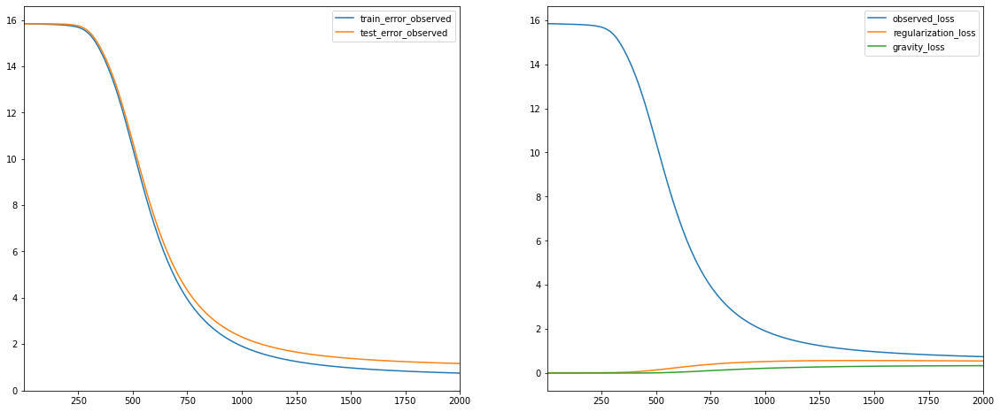

In [49]:
reg_model = build_regularized_model(
    user_ratings, regularization_coeff=0.1, gravity_coeff=1.0, embedding_dim=35,
    init_stddev=.05)
reg_model.train(num_iterations=2000, learning_rate=20.)

In [50]:
# when you added your own ratings for the movies
# user_recommendations(reg_model, DOT, exclude_rated=True, k=10) 

In [51]:
book_neighbors(reg_model, "Harry Potter", DOT)
book_neighbors(reg_model, "Harry Potter", COSINE)

Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: A Pop-Up Book: Based on the Film Phenomenon, Harry Potter an

,dot score,titles,genres
3041,5.379,Between Sisters,fiction-romance
9531,5.271,"The Marvelous Land of Oz (Oz, #2)",fantasy-young-adult-adventure-fiction-sci-fi-f...
7039,5.090,Don't Go,fiction-mystery-romance
8548,5.052,I Will Teach You To Be Rich,Other
9110,5.044,Maximum City: Bombay Lost and Found,fiction
4054,5.038,Jesus' Son,fiction


Nearest neighbors of : Harry Potter and the Sorcerer's Stone (Harry Potter, #1).
[Found more than one matching book. Other candidates: Harry Potter and the Prisoner of Azkaban (Harry Potter, #3), Harry Potter and the Order of the Phoenix (Harry Potter, #5), Harry Potter and the Chamber of Secrets (Harry Potter, #2), Harry Potter and the Goblet of Fire (Harry Potter, #4), Harry Potter and the Deathly Hallows (Harry Potter, #7), Harry Potter and the Half-Blood Prince (Harry Potter, #6), Harry Potter and the Cursed Child - Parts One and Two (Harry Potter, #8), Harry Potter Boxset (Harry Potter, #1-7), Harry Potter: Film Wizardry, The Harry Potter Collection 1-4 (Harry Potter, #1-4), Harry Potter and the Chamber of Secrets: Sheet Music for Flute with C.D, Harry Potter Boxed Set, Books 1-5 (Harry Potter, #1-5), Harry Potter Page to Screen: The Complete Filmmaking Journey, Harry Potter Collection (Harry Potter, #1-6), Harry Potter: A Pop-Up Book: Based on the Film Phenomenon, Harry Potter an

,cosine score,titles,genres
1,1.000,Harry Potter and the Sorcerer's Stone (Harry P...,fantasy-young-adult-adventure-fiction-children
17,0.979,Harry Potter and the Prisoner of Azkaban (Harr...,fantasy-young-adult-adventure-fiction-children
20,0.963,Harry Potter and the Order of the Phoenix (Har...,fantasy-young-adult-fiction-children-paranormal
37,0.960,The Time Traveler's Wife,fantasy-fiction-sci-fi-fantasy-paranormal-romance
38,0.959,"A Game of Thrones (A Song of Ice and Fire, #1)",fantasy-adventure-fiction-sci-fi-fantasy-romance
50,0.958,"City of Bones (The Mortal Instruments, #1)",fantasy-young-adult-fiction-paranormal-romance


In [52]:
book_embedding_norm([model, model_lowinit, reg_model])

alt.HConcatChart(...)

In [53]:
tsne_movie_embeddings(reg_model)

Running t-SNE...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.001s...
[t-SNE] Computed neighbors for 10000 samples in 1.932s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 0.082791
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.460190
[t-SNE] KL divergence after 400 iterations: 2.398158


alt.HConcatChart(...)